In [1]:
import pandas as pd 
import numpy as np 
import seaborn as sns
import matplotlib.pyplot as plt 
from scipy import optimize
print('Modules are imported.')

Modules are imported.


In [2]:
covid_india=pd.read_csv('/home/lucina/Documents/Datasets/CORONA 11 Aug 2021/covid_19_india.csv')

In [3]:
covid_vaccine_india=pd.read_csv('/home/lucina/Documents/Datasets/CORONA 11 Aug 2021/covid_vaccine_statewise.csv')

In [4]:
covid_testing_india=pd.read_csv('/home/lucina/Documents/Datasets/CORONA 11 Aug 2021/StatewiseTestingDetails.csv')

In [5]:
covid_india.head()

,Sno,Date,Time,State/UnionTerritory,ConfirmedIndianNational,ConfirmedForeignNational,Cured,Deaths,Confirmed
0,1,2020-01-30,6:00 PM,Kerala,1,0,0,0,1
1,2,2020-01-31,6:00 PM,Kerala,1,0,0,0,1
2,3,2020-02-01,6:00 PM,Kerala,2,0,0,0,2
3,4,2020-02-02,6:00 PM,Kerala,3,0,0,0,3
4,5,2020-02-03,6:00 PM,Kerala,3,0,0,0,3


In [6]:
covid_vaccine_india.head()

,Updated On,State,Total Doses Administered,Sessions,Sites,First Dose Administered,Second Dose Administered,Male (Doses Administered),Female (Doses Administered),Transgender (Doses Administered),...,18-44 Years (Doses Administered),45-60 Years (Doses Administered),60+ Years (Doses Administered),18-44 Years(Individuals Vaccinated),45-60 Years(Individuals Vaccinated),60+ Years(Individuals Vaccinated),Male(Individuals Vaccinated),Female(Individuals Vaccinated),Transgender(Individuals Vaccinated),Total Individuals Vaccinated
0,16/01/2021,India,48276.0,3455.0,2957.0,48276.0,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,23757.0,24517.0,2.0,48276.0
1,17/01/2021,India,58604.0,8532.0,4954.0,58604.0,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,27348.0,31252.0,4.0,58604.0
2,18/01/2021,India,99449.0,13611.0,6583.0,99449.0,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,41361.0,58083.0,5.0,99449.0
3,19/01/2021,India,195525.0,17855.0,7951.0,195525.0,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,81901.0,113613.0,11.0,195525.0
4,20/01/2021,India,251280.0,25472.0,10504.0,251280.0,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,98111.0,153145.0,24.0,251280.0


In [7]:
covid_testing_india.head()

,Date,State,TotalSamples,Negative,Positive
0,2020-04-17,Andaman and Nicobar Islands,1403.0,1210,12.0
1,2020-04-24,Andaman and Nicobar Islands,2679.0,NaN,27.0
2,2020-04-27,Andaman and Nicobar Islands,2848.0,NaN,33.0
3,2020-05-01,Andaman and Nicobar Islands,3754.0,NaN,33.0
4,2020-05-16,Andaman and Nicobar Islands,6677.0,NaN,33.0


In [8]:
covid_india.columns=['Sno','Date','Time','State','Confirmed_Indian','Confirmed_Foreign','Cured', 'Deaths', 'Confirmed']

In [9]:
covid_india.head()

,Sno,Date,Time,State,Confirmed_Indian,Confirmed_Foreign,Cured,Deaths,Confirmed
0,1,2020-01-30,6:00 PM,Kerala,1,0,0,0,1
1,2,2020-01-31,6:00 PM,Kerala,1,0,0,0,1
2,3,2020-02-01,6:00 PM,Kerala,2,0,0,0,2
3,4,2020-02-02,6:00 PM,Kerala,3,0,0,0,3
4,5,2020-02-03,6:00 PM,Kerala,3,0,0,0,3


In [10]:
covid_vaccine_india.columns=['Date','State','Total_Doses_Admstered', 'Sessions','Sites', 'First_Dose_Administered','Second_Dose_Administered','Male_Doses_Administered','Female_Doses_Administered','Transgender_Doses_Administered','Covaxin_Doses_Administered','CoviShield_Doses_Administered', 'Sputnik_V_Doses_Administered','AEFI','Doses_Administered_18_44','Doses_Administered_45_60','Doses_Administered_60_Plus','Individuals_Vaccinated_18_44','Individuals_Vaccinated_45_60','Individuals_Vaccinated_60_Plus','Male_Individuals_Vaccinated','Female_Individuals_Vaccinated','Transgender_Individuals_Vaccinated','Total_Individuals_Vaccinated']

In [11]:
covid_vaccine_india.head()

,Date,State,Total_Doses_Admstered,Sessions,Sites,First_Dose_Administered,Second_Dose_Administered,Male_Doses_Administered,Female_Doses_Administered,Transgender_Doses_Administered,...,Doses_Administered_18_44,Doses_Administered_45_60,Doses_Administered_60_Plus,Individuals_Vaccinated_18_44,Individuals_Vaccinated_45_60,Individuals_Vaccinated_60_Plus,Male_Individuals_Vaccinated,Female_Individuals_Vaccinated,Transgender_Individuals_Vaccinated,Total_Individuals_Vaccinated
0,16/01/2021,India,48276.0,3455.0,2957.0,48276.0,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,23757.0,24517.0,2.0,48276.0
1,17/01/2021,India,58604.0,8532.0,4954.0,58604.0,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,27348.0,31252.0,4.0,58604.0
2,18/01/2021,India,99449.0,13611.0,6583.0,99449.0,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,41361.0,58083.0,5.0,99449.0
3,19/01/2021,India,195525.0,17855.0,7951.0,195525.0,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,81901.0,113613.0,11.0,195525.0
4,20/01/2021,India,251280.0,25472.0,10504.0,251280.0,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,98111.0,153145.0,24.0,251280.0


In [12]:
covid_maha=covid_vaccine_india[covid_vaccine_india.State=='Maharashtra']

In [13]:
covid_maha.head()

,Date,State,Total_Doses_Admstered,Sessions,Sites,First_Dose_Administered,Second_Dose_Administered,Male_Doses_Administered,Female_Doses_Administered,Transgender_Doses_Administered,...,Doses_Administered_18_44,Doses_Administered_45_60,Doses_Administered_60_Plus,Individuals_Vaccinated_18_44,Individuals_Vaccinated_45_60,Individuals_Vaccinated_60_Plus,Male_Individuals_Vaccinated,Female_Individuals_Vaccinated,Transgender_Individuals_Vaccinated,Total_Individuals_Vaccinated
4453,16/01/2021,Maharashtra,5726.0,179.0,174.0,5726.0,0.0,3668.0,2057.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5726.0
4454,17/01/2021,Maharashtra,6521.0,269.0,216.0,6521.0,0.0,3953.0,2566.0,2.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6521.0
4455,18/01/2021,Maharashtra,6151.0,772.0,320.0,6151.0,0.0,3569.0,2581.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6151.0
4456,19/01/2021,Maharashtra,13699.0,1196.0,340.0,13699.0,0.0,6328.0,7367.0,4.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13699.0
4457,20/01/2021,Maharashtra,23880.0,1547.0,347.0,23880.0,0.0,9658.0,14205.0,17.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,23880.0


In [14]:
from scipy.interpolate import make_interp_spline
import matplotlib.pyplot as plt

([0,
  1,
  2,
  3,
  4,
  5,
  6,
  7,
  8,
  9,
  10,
  11,
  12,
  13,
  14,
  15,
  16,
  17,
  18,
  19,
  20,
  21,
  22,
  23,
  24,
  25,
  26,
  27,
  28,
  29,
  30,
  31,
  32,
  33,
  34,
  35,
  36,
  37,
  38,
  39,
  40,
  41,
  42,
  43,
  44,
  45,
  46,
  47,
  48,
  49,
  50,
  51,
  52,
  53,
  54,
  55,
  56,
  57,
  58,
  59,
  60,
  61,
  62,
  63,
  64,
  65,
  66,
  67,
  68,
  69,
  70,
  71,
  72,
  73,
  74,
  75,
  76,
  77,
  78,
  79,
  80,
  81,
  82,
  83,
  84,
  85,
  86,
  87,
  88,
  89,
  90,
  91,
  92,
  93,
  94,
  95,
  96,
  97,
  98,
  99,
  100,
  101,
  102,
  103,
  104,
  105,
  106,
  107,
  108,
  109,
  110,
  111,
  112,
  113,
  114,
  115,
  116,
  117,
  118,
  119,
  120,
  121,
  122,
  123,
  124,
  125,
  126,
  127,
  128,
  129,
  130,
  131,
  132,
  133,
  134,
  135,
  136,
  137,
  138,
  139,
  140,
  141,
  142,
  143,
  144,
  145,
  146,
  147,
  148,
  149,
  150,
  151,
  152,
  153,
  154,
  155,
  156,
  157,
  15

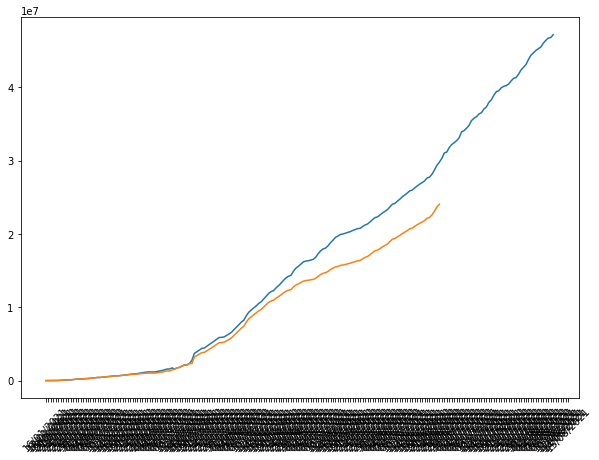

In [15]:
plt.rcParams["figure.figsize"] = (10,7)
plt.plot(covid_maha['Date'], covid_maha['Total_Doses_Admstered'], label='Total Doses Admnstered')
#plt.legend(['Total Doses Admstered'])
plt.plot(covid_maha['Date'], covid_maha['Total_Individuals_Vaccinated'], label='Total Individuals Vaccinated')
#plt.legend(['Total Indivisuals Vaccinated'])
plt.xticks(rotation=45)


In [16]:
import seaborn as snb

AttributeError: 'FacetGrid' object has no attribute 'figure'

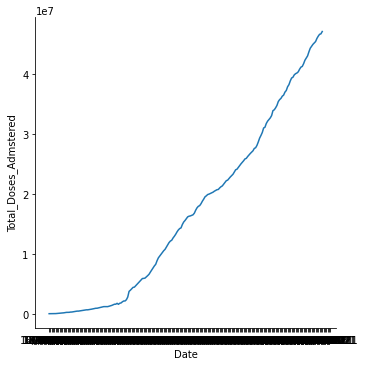

In [17]:
g = snb.relplot(x=covid_maha['Date'], y=covid_maha['Total_Doses_Admstered'], kind="line", data=covid_maha)
#g=snb.relplot(x=covid_maha['Date'], y=covid_maha['Total_Individuals_Vaccinated'], kind="line", data=covid_maha)
g.figure.autofmt_xdate()

In [ ]:
g=snb.relplot(x=covid_maha['Date'], y=covid_maha['Total_Individuals_Vaccinated'], kind="line", data=covid_maha)

In [ ]:
covid_maha.plot()

In [18]:
import seaborn as snb
snb.relplot(
    data=covid_maha, kind="line",
    x="Date", y=covid_maha['Total_Doses_Admstered'], col=covid_maha['Total_Individuals_Vaccinated'],
    hue=covid_maha['First_Dose_Administered'], size=covid_maha['Sessions'], style=covid_maha['First_Dose_Administered'],
    facet_kws=dict(sharex=False),)

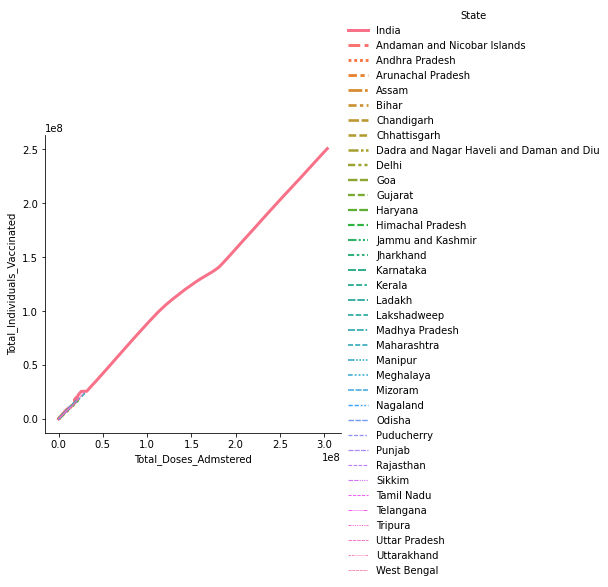

In [19]:
snb.relplot(
    data=covid_india, kind="line",
    x=covid_vaccine_india['Total_Doses_Admstered'], y=covid_vaccine_india['Total_Individuals_Vaccinated'],
    hue=covid_vaccine_india['State'], size=covid_vaccine_india['State'], style=covid_vaccine_india['State'],
    facet_kws=dict(sharex=False),)

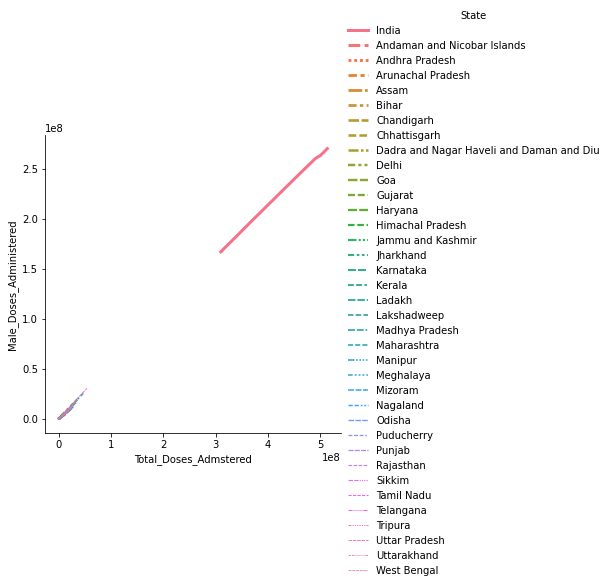

In [20]:
snb.relplot(
    data=covid_india, kind="line",
    x=covid_vaccine_india['Total_Doses_Admstered'], y=covid_vaccine_india['Male_Doses_Administered'],
    hue=covid_vaccine_india['State'], size=covid_vaccine_india['State'], style=covid_vaccine_india['State'],
    facet_kws=dict(sharex=False),)

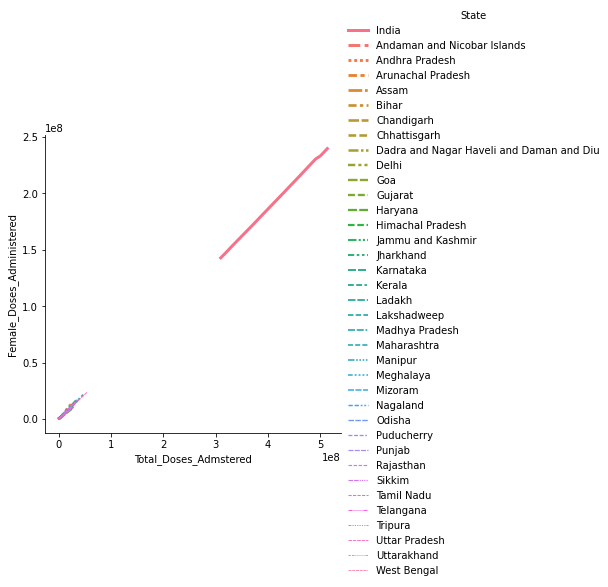

In [21]:
snb.relplot(
    data=covid_india, kind="line",
    x=covid_vaccine_india['Total_Doses_Admstered'], y=covid_vaccine_india['Female_Doses_Administered'],
    hue=covid_vaccine_india['State'], size=covid_vaccine_india['State'], style=covid_vaccine_india['State'],
    facet_kws=dict(sharex=False),)

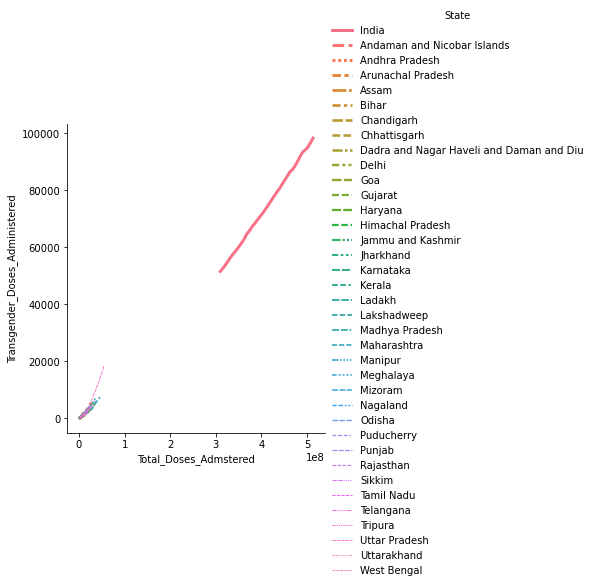

In [22]:
snb.relplot(
    data=covid_india, kind="line",
    x=covid_vaccine_india['Total_Doses_Admstered'], y=covid_vaccine_india['Transgender_Doses_Administered'],
    hue=covid_vaccine_india['State'], size=covid_vaccine_india['State'], style=covid_vaccine_india['State'],
    facet_kws=dict(sharex=False),)

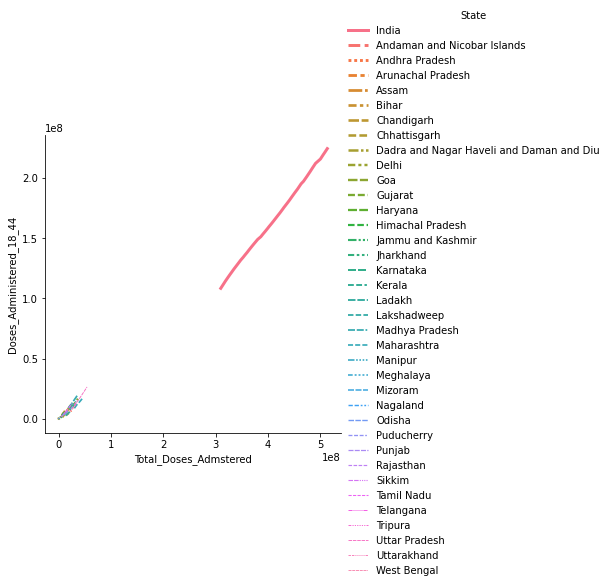

In [23]:
snb.relplot(
    data=covid_india, kind="line",
    x=covid_vaccine_india['Total_Doses_Admstered'], y=covid_vaccine_india['Doses_Administered_18_44'],
    hue=covid_vaccine_india['State'], size=covid_vaccine_india['State'], style=covid_vaccine_india['State'],
    facet_kws=dict(sharex=False),)

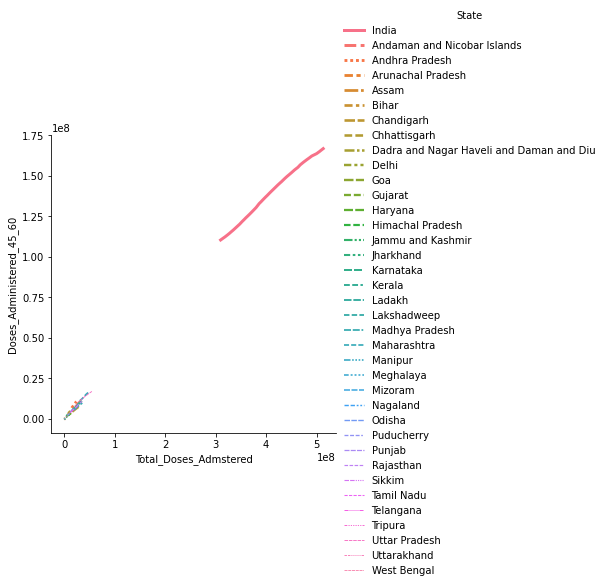

In [24]:
snb.relplot(
    data=covid_india, kind="line",
    x=covid_vaccine_india['Total_Doses_Admstered'], y=covid_vaccine_india['Doses_Administered_45_60'],
    hue=covid_vaccine_india['State'], size=covid_vaccine_india['State'], style=covid_vaccine_india['State'],
    facet_kws=dict(sharex=False),)

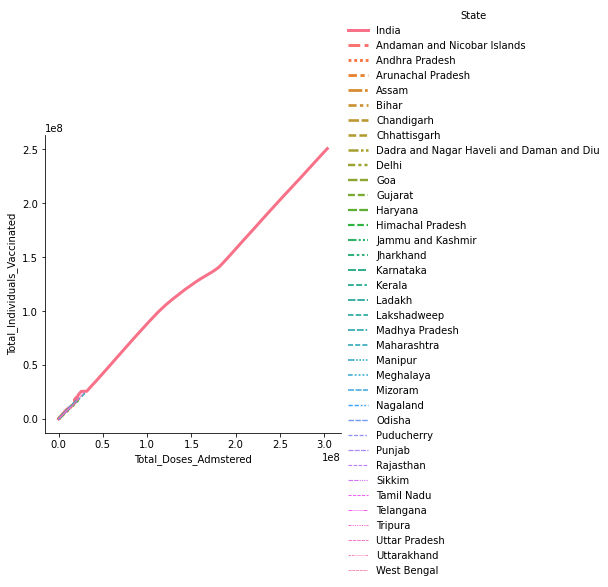

In [25]:
snb.relplot(
    data=covid_india, kind="line",
    x=covid_vaccine_india['Total_Doses_Admstered'], y=covid_vaccine_india['Total_Individuals_Vaccinated'],
    hue=covid_vaccine_india['State'], size=covid_vaccine_india['State'], style=covid_vaccine_india['State'],
    facet_kws=dict(sharex=False),)

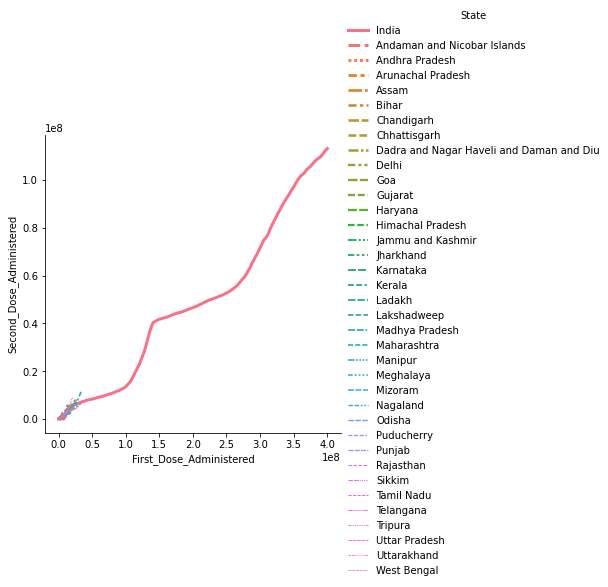

In [26]:
snb.relplot(
    data=covid_india, kind="line",
    x=covid_vaccine_india['First_Dose_Administered'], y=covid_vaccine_india['Second_Dose_Administered'],
    hue=covid_vaccine_india['State'], size=covid_vaccine_india['State'], style=covid_vaccine_india['State'],
    facet_kws=dict(sharex=False),)

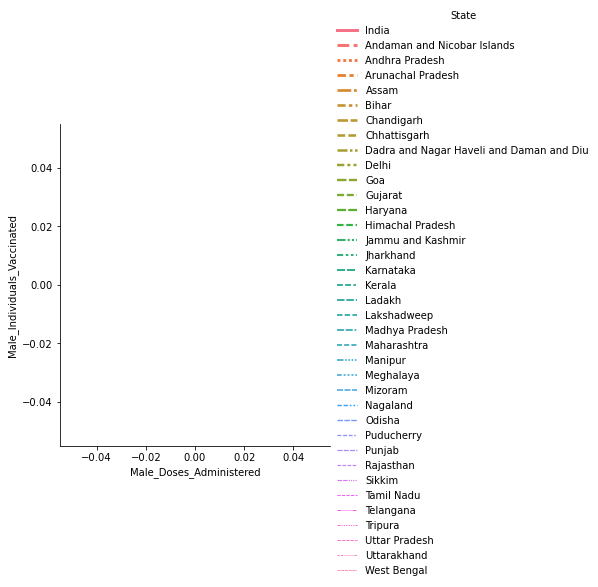

In [27]:
snb.relplot(
    data=covid_india, kind="line",
    x=covid_vaccine_india['Male_Doses_Administered'], y=covid_vaccine_india['Male_Individuals_Vaccinated'],
    hue=covid_vaccine_india['State'], size=covid_vaccine_india['State'], style=covid_vaccine_india['State'],
    facet_kws=dict(sharex=False),)

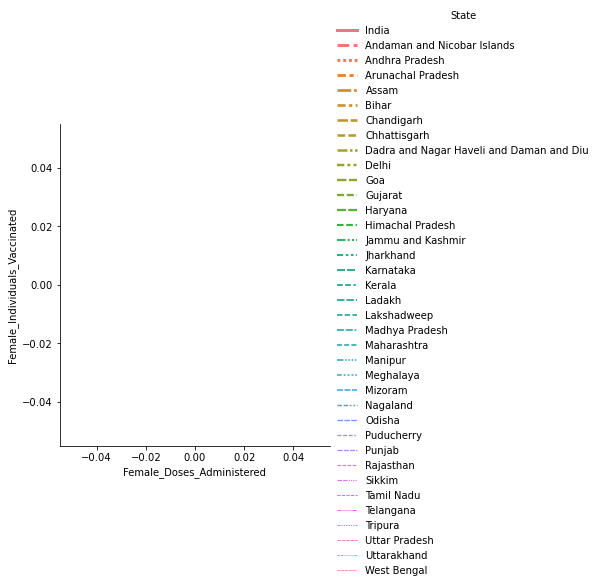

In [28]:
snb.relplot(
    data=covid_india, kind="line",
    x=covid_vaccine_india['Female_Doses_Administered'], y=covid_vaccine_india['Female_Individuals_Vaccinated'],
    hue=covid_vaccine_india['State'], size=covid_vaccine_india['State'], style=covid_vaccine_india['State'],
    facet_kws=dict(sharex=False),)

In [30]:
import pandas_datareader as pdr
import matplotlib.pyplot as plt

In [31]:
stocks=['GOOG','AMZN']

In [32]:
data=pdr.get_data_yahoo(stocks, start='2019-01-01')['Close']

In [33]:
data.head()

Symbols,GOOG,AMZN
Date,,
2018-12-31,1035.609985,1501.969971
2019-01-02,1045.849976,1539.130005
2019-01-03,1016.059998,1500.280029
2019-01-04,1070.709961,1575.390015
2019-01-07,1068.390015,1629.510010


No handles with labels found to put in legend.


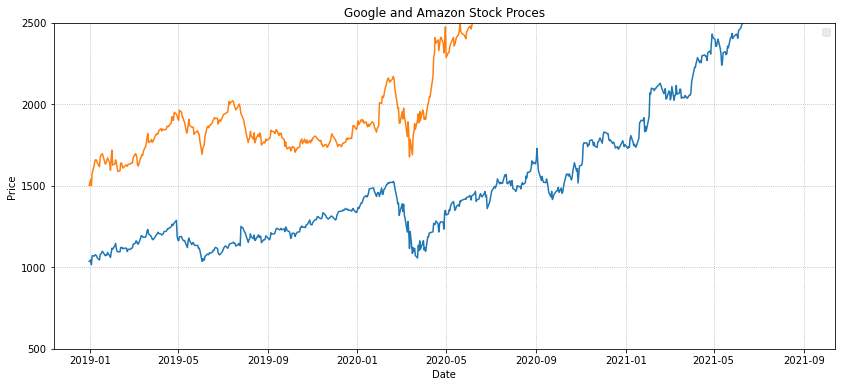

In [34]:
from matplotlib import rcParams
rcParams['figure.figsize']=14,6
plt.plot(data.GOOG)
plt.plot(data.AMZN)
plt.grid(True, linestyle=':')
plt.title('Google and Amazon Stock Proces')
plt.xlabel("Date")
plt.ylabel("Price")
plt.ylim(500,2500)
plt.yticks([500,1000,1500,2000,2500])
plt.style.use('ggplot')
plt.legend()

In [2]:
import pandas as pd
import matplotlib.pyplot as plt 
%matplotlib inline
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import folium
from folium import plugins
    

In [3]:
df=pd.read_csv('/home/lucina/Documents/Datasets/CORONA 11 Aug 2021/covid_19_india.csv')

In [6]:
df.style.background_gradient(cmap='Reds')

In [7]:
df['Total_Active_Cases']=df['Confirmed']-(df['Cured']+df['Deaths'])

In [8]:
Total_Active=df['Total_Active_Cases'].sum()

In [14]:
Total_Cases=df.groupby('State/UnionTerritory')['Total_Active_Cases'].sum().sort_values(ascending=False).to_frame

In [15]:
Total_Cases.style.background_gradient(cmap='Reds')

AttributeError: 'function' object has no attribute 'style'